## Importing packages

In [1]:
#importing required packages
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
import glob
%matplotlib inline

In [3]:
os.chdir('/home/devesh/udac_nd/CarND-Advanced-Lane-Lines')

In [4]:
os.listdir('./test_images')

['test1.jpg',
 'test2.jpg',
 'straight_lines1.jpg',
 'test5.jpg',
 'straight_lines2.jpg',
 'test6.jpg',
 'test4.jpg',
 'test3.jpg']

This image is: <class 'numpy.ndarray'> with dimensions: (720, 1280, 3)


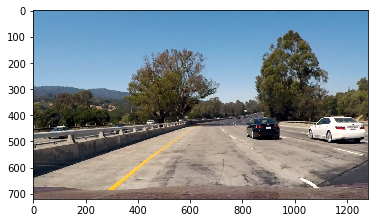

In [5]:
image1 = mpimg.imread('./test_images/test1.jpg')

print('This image is:', type(image1), 'with dimensions:', image1.shape)
plt.imshow(image1)  

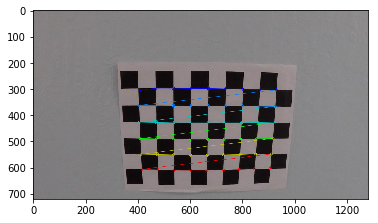

In [6]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for idx, fname in enumerate(images):
    img = cv2.imread(fname)
    grayImg = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(grayImg, (9,6), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        cv2.drawChessboardCorners(img, (9,6), corners, ret)
        #write_name = 'corners_found'+str(idx)+'.jpg'
        #cv2.imwrite(write_name, img)
       # cv2.imshow('img', img)
        plt.imshow(img)
       # cv2.waitKey(500)

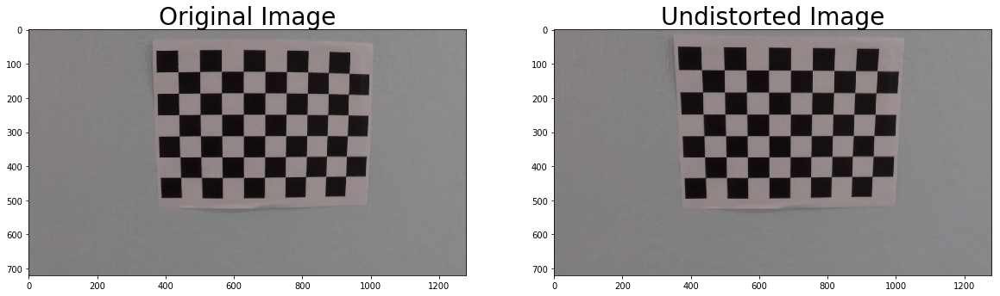

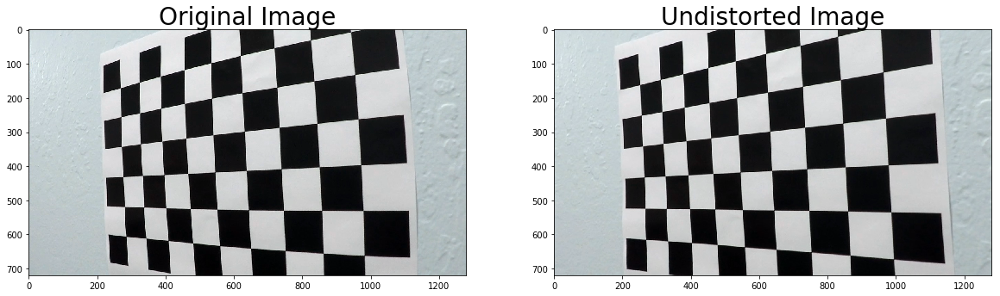

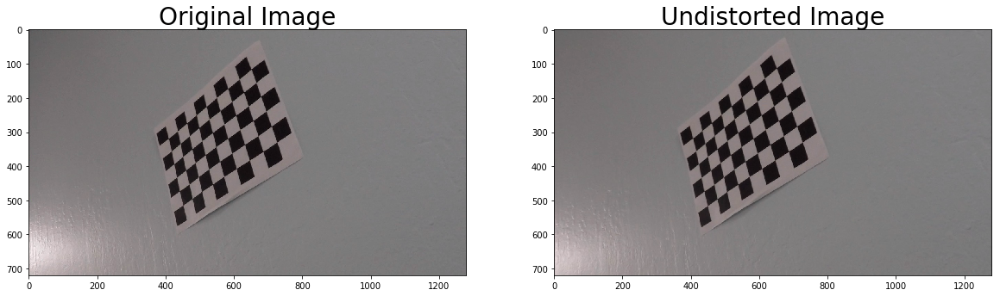

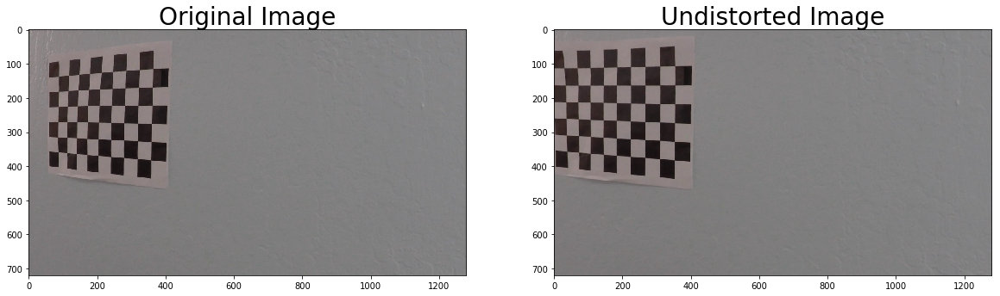

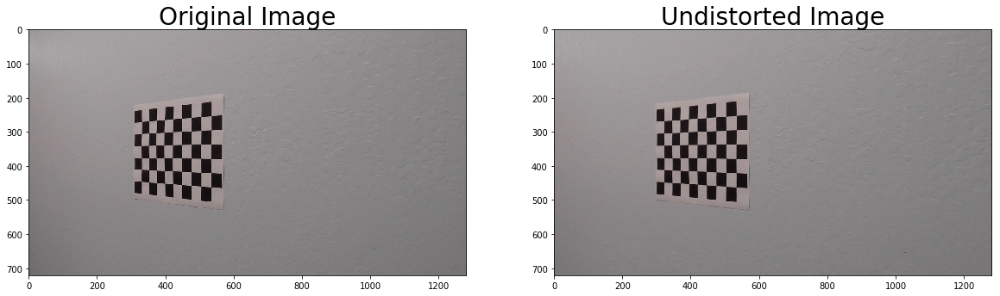

...

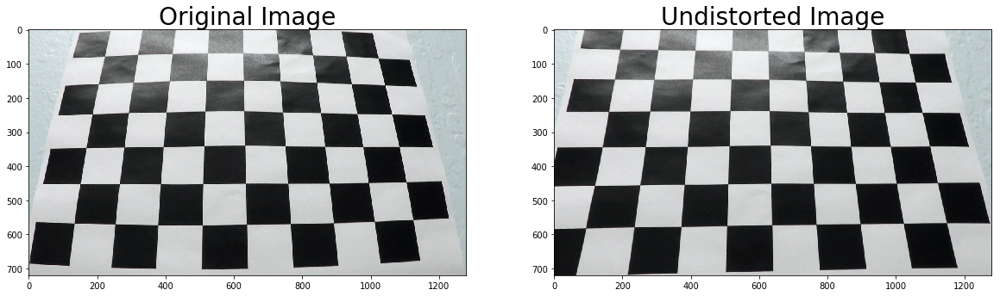

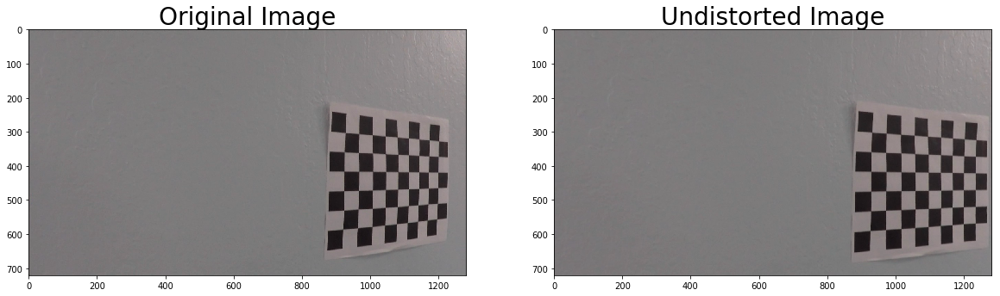

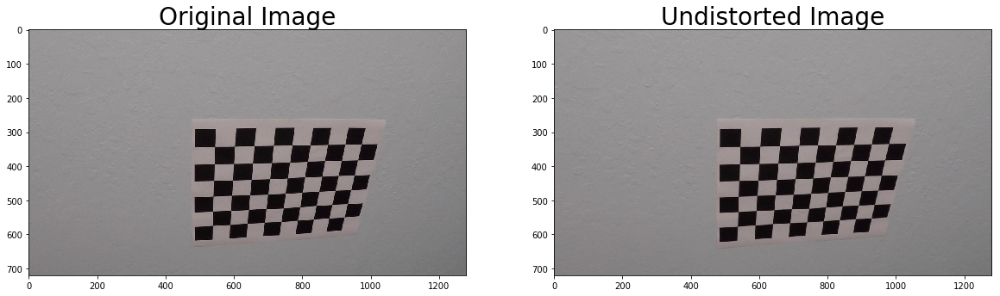

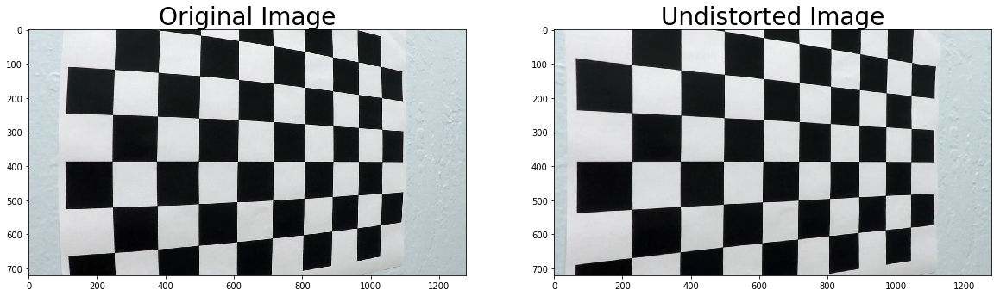

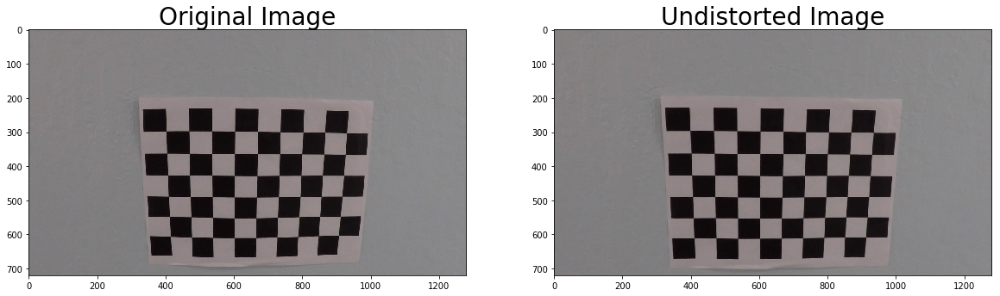

In [7]:

for img in images:
    cal_img = cv2.imread(img)
    img_size = (cal_img.shape[1], cal_img.shape[0])

    # Do camera calibration given object points and image points
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)


    dst = cv2.undistort(cal_img, mtx, dist, None, mtx)
    #cv2.imwrite('./camera_cal_output/'+img.split('/')[-1],dst)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(cal_img)
    ax1.set_title('Original Image', fontsize=28)
    ax2.imshow(dst)
    ax2.set_title('Undistorted Image', fontsize=28)
    plt.savefig('./camera_cal_output/'+'op'+img.split('/')[-1])
    cv2#.imwrite('./camera_cal_output/'+img.split('/')[-1],(ax1,ax2))



In [8]:
def region_of_interest(img):
    vertices = [(0, img.shape[0]),(img.shape[1] / 2, img.shape[0] / 2),
    (img.shape[1], img.shape[0]),]
    
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image


# Calculate directional gradient
def abs_sobel_thresh(img, orient='x', thresh=(0, 255), sobel_kernel=3):
    thresh_min, thresh_max = thresh
    s_thresh = (120, 255)
    l_thresh = (30, 255)
    
    hls_image = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)

    H = hls_image[:,:,0]
    L = hls_image[:,:,1]
    S = hls_image[:,:,2]
    
    if orient == 'x':
        sobel = cv2.Sobel(L, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    else:
        sobel = cv2.Sobel(L, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    abs_sobel = np.absolute(sobel)
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))

    l_sobel = np.zeros_like(scaled_sobel)
    l_sobel[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
    
    s_binary = np.zeros_like(S)
    s_binary[(S >= s_thresh[0]) & (S <= s_thresh[1])] = 1
    
    l_binary = np.zeros_like(L)
    l_binary[(L >= l_thresh[0]) & (L <= l_thresh[1])] = 1
    
    binary_output = np.zeros_like(l_sobel)
    binary_output[((l_binary == 1) & (s_binary == 1) | (l_sobel==1))] = 1  
    
    return binary_output

def mag_thresh(img, sobel_kernel=3, thresh=(0,255)):
    
    img = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)[:,:,2]
    
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8)
    
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= thresh[0]) & (gradmag <= thresh[1])] = 1
    
    return binary_output

def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):   
    
    img = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)[:,:,2]
    
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)
    
    dirs = np.arctan2(abs_sobely, abs_sobelx)
    
    binary_output = np.zeros_like(dirs)
    binary_output[(dirs >= thresh[0]) & (dirs <= thresh[1])] = 1
    
    return binary_output

def combined_thresh(img, sobel_kernel=3, abs_thresh=(15,255), _mag_thresh=(15,255), dir_thresh=(0, np.pi/2)):
    gradx = abs_sobel_thresh(img, orient='x', sobel_kernel=sobel_kernel, thresh=abs_thresh)
    
    mag_binary = mag_thresh(img, sobel_kernel=sobel_kernel, thresh=_mag_thresh)
    
    dir_binary = dir_threshold(img, sobel_kernel=sobel_kernel, thresh=dir_thresh)
    
    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) ) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    
    return combined

In [9]:
def warp_image(img):
    height, width = img.shape[0:2]
    
    src = np.float32(
        [
            [580.0, 460.0],
            [740.0, 460.0],
            [1100.0, 670.0],
            [270.0, 670.0],
        ]
    )
    dst = np.float32(
        [
            [200.0, 0],
            [width - 200.0, 0],
            [width - 200.0, height],
            [200.0, height],
        ]
    )
    
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warped = cv2.warpPerspective(img, M, (width, height), flags=cv2.INTER_LINEAR)
    
    return warped, M, Minv

In [42]:
def hist(img):
    bottom_half = img[img.shape[0]//2:,:]
    histogram = np.sum(bottom_half, axis=0)
    return histogram

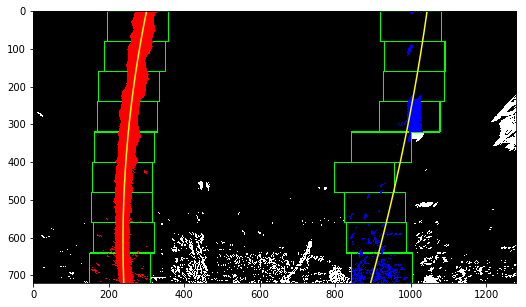

In [17]:
def sliding_window_polyfit(img):
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = hist(img)
    # Create an output image to draw on and  visualize the result
    out_img = np.uint8(np.dstack((img, img, img))*255)
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(img.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 80
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = img.shape[0] - (window+1)*window_height
        win_y_high = img.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    return left_fit, right_fit, left_lane_inds, right_lane_inds, out_img

def visualize_polyfit(img, out_img, left_fit, right_fit, left_lane_inds, right_lane_inds):
    ploty = np.linspace(0, img.shape[0]-1, img.shape[0])
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    
    plt.figure(figsize = (10,5))
    plt.imshow(out_img)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)

left_fit, right_fit, left_lane_inds, right_lane_inds, out_img = sliding_window_polyfit(combined)

visualize_polyfit(combined, out_img, left_fit, right_fit, left_lane_inds, right_lane_inds)

In [16]:
def skip_windows_step(binary_warped, left_fit, right_fit):
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 80
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
    left_fit[1]*nonzeroy + left_fit[2] + margin))) 

    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
    right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    return out_img, left_fit, right_fit, left_lane_inds, right_lane_inds
    
def visualize_skip_window_step(binary_warped, out_img, left_fitx, right_fitx, left_lane_inds, right_lane_inds):
    margin = 80    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Create an image to draw on and an image to show the selection window
    out_img = np.uint8(np.dstack((binary_warped, binary_warped, binary_warped))*255)
    window_img = np.zeros_like(out_img)
    
    # Color in left and right line pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    plt.figure(figsize = (10,5))
    plt.imshow(result)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)

#out_img, left_fit2, right_fit2, left_lane_inds2, right_lane_inds2 = skip_windows_step(combined, left_fit, right_fit)

#visualize_skip_window_step(combined, out_img, left_fit2, right_fit2, left_lane_inds2, right_lane_inds2)

In [15]:
def measure_curvature(binary_warped, left_lane_inds, right_lane_inds):
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])
    y_eval = np.max(ploty)
    
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    return left_curverad, right_curverad

def measure_car_pos(binary_warped, left_fit, right_fit):
    xm_per_pix = 3.7/700
    car_position = binary_warped.shape[1]/2
    height = binary_warped.shape[0]
    
    left_fit_x = left_fit[0]*height**2 + left_fit[1]*height + left_fit[2]
    right_fit_x = right_fit[0]*height**2 + right_fit[1]*height + right_fit[2]
    
    lane_center_position = (right_fit_x + left_fit_x) /2
    
    center_dist = (car_position - lane_center_position) * xm_per_pix
    
    return center_dist

#left_curverad, right_curverad = measure_curvature(combined, left_lane_inds2, right_lane_inds2)

#print(left_curverad, 'm', right_curverad, 'm')

#car_pos = measure_car_pos(combined, left_fit2, right_fit2)

#print(car_pos, 'm')

In [14]:
def draw_lines(original_img, binary_img, left_fit, right_fit, Minv):
    ploty = np.linspace(0, binary_img.shape[0]-1, binary_img.shape[0])
    
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_img).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (original_img.shape[1], original_img.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(original_img, 1, newwarp, 0.3, 0)
    
    return result

#new_img = draw_lines(original_images[5], combined, left_fit, right_fit, Minvs[5])
#plt.imshow(new_img)

In [13]:
def draw_curvature_data(img, curv_rad, car_pos):
    font = cv2.FONT_HERSHEY_DUPLEX
    text = 'Curve radius-' + '{:02.2f}'.format(curv_rad/1000) + 'km'
    cv2.putText(img, text, (30,70), font, 1.5, (0,0,0), 2, cv2.LINE_AA)
    
    text = 'Car pos. from center: ' + '{:02.3f}'.format(car_pos) + 'm'
    cv2.putText(img, text, (30,120), font, 1.5, (0,0,0), 2, cv2.LINE_AA)
    
    return img
   

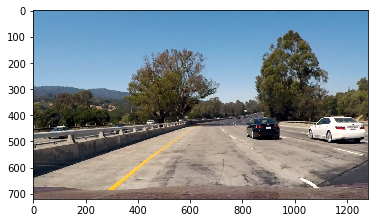

In [11]:
img = cv2.imread('./test_images/test1.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img, cmap='gray')









In [39]:
type(img)

numpy.ndarray

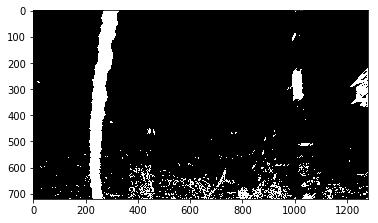

In [12]:
undist = cv2.undistort(img, mtx, dist, None, mtx)
# recived undistored image
plt.imshow(undist, cmap='gray')

# wrap image 

warped_image,M,Minv= warp_image(undist)

combined = combined_thresh(warped_image, sobel_kernel=3, abs_thresh=(20,255), _mag_thresh=(20,255), dir_thresh=(0, np.pi/2))

plt.imshow(combined, cmap='gray')


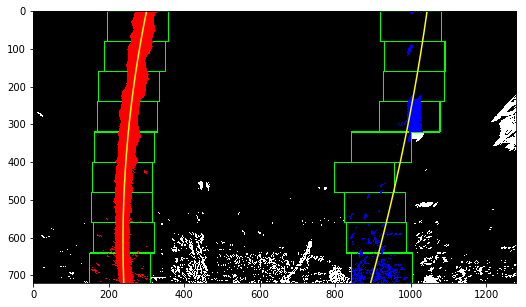

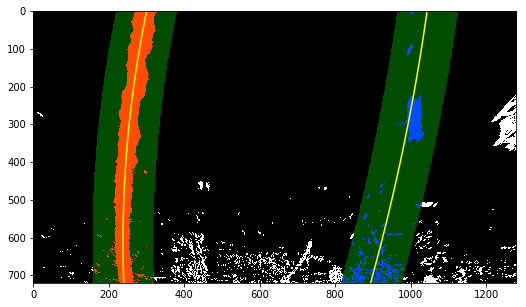

In [18]:
left_fit, right_fit, left_lane_inds, right_lane_inds, out_img = sliding_window_polyfit(combined)

visualize_polyfit(combined, out_img, left_fit, right_fit, left_lane_inds, right_lane_inds)

out_img, left_fit2, right_fit2, left_lane_inds2, right_lane_inds2 = skip_windows_step(combined, left_fit, right_fit)

visualize_skip_window_step(combined, out_img, left_fit2, right_fit2, left_lane_inds2, right_lane_inds2)

947.7182813285364 m 519.7414923492813 m
0.4065741330718126 m


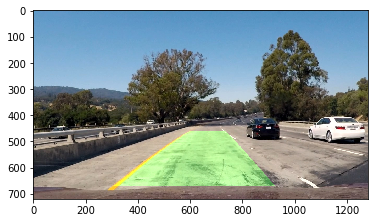

In [19]:
left_curverad, right_curverad = measure_curvature(combined, left_lane_inds2, right_lane_inds2)

print(left_curverad, 'm', right_curverad, 'm')

car_pos = measure_car_pos(combined, left_fit2, right_fit2)

print(car_pos, 'm')

new_img = draw_lines(img, combined, left_fit, right_fit, Minv)
plt.imshow(new_img)


In [41]:
allImages=os.listdir('./test_images')
allImages

['test1.jpg',
 'test2.jpg',
 'straight_lines1.jpg',
 'test5.jpg',
 'straight_lines2.jpg',
 'test6.jpg',
 'test4.jpg',
 'test3.jpg']

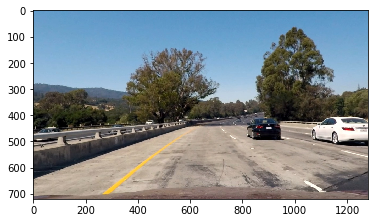

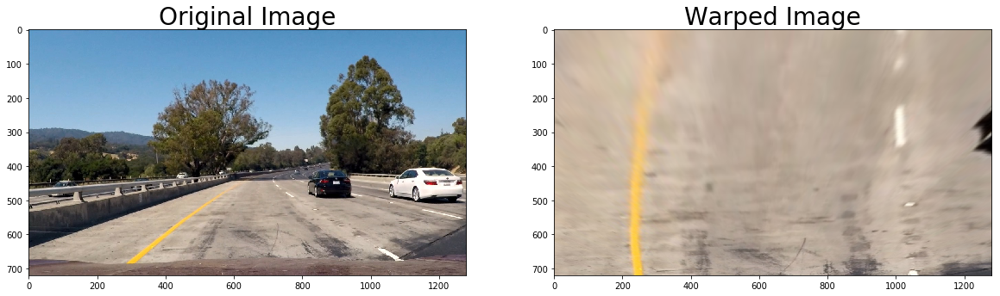

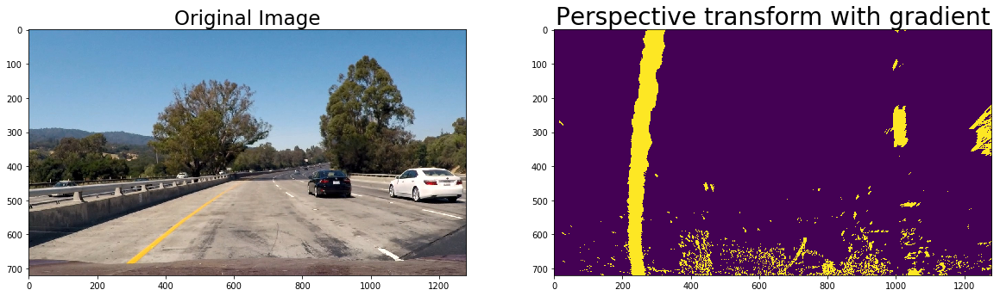

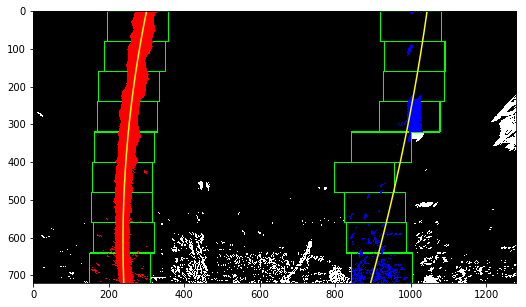

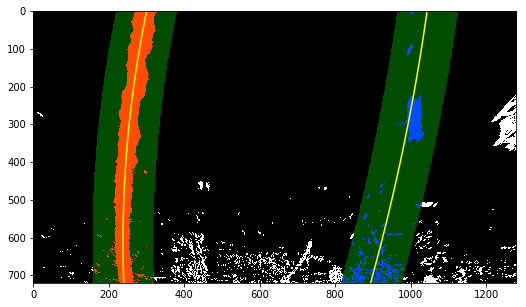

...

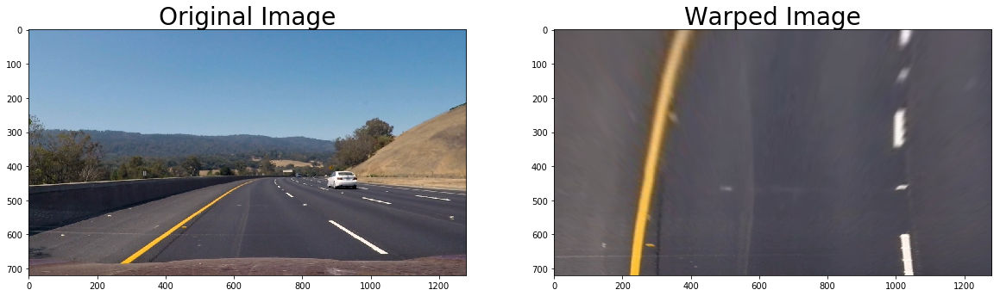

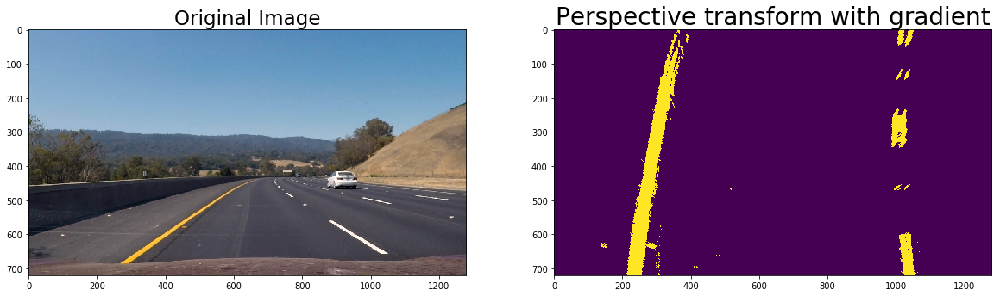

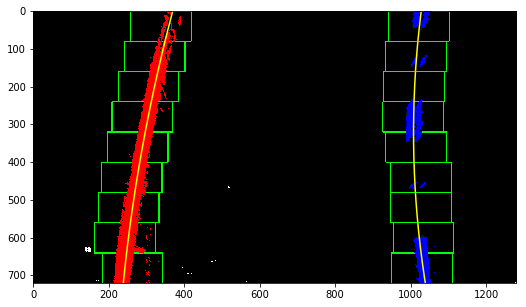

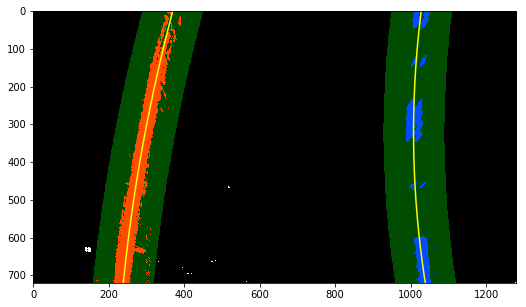

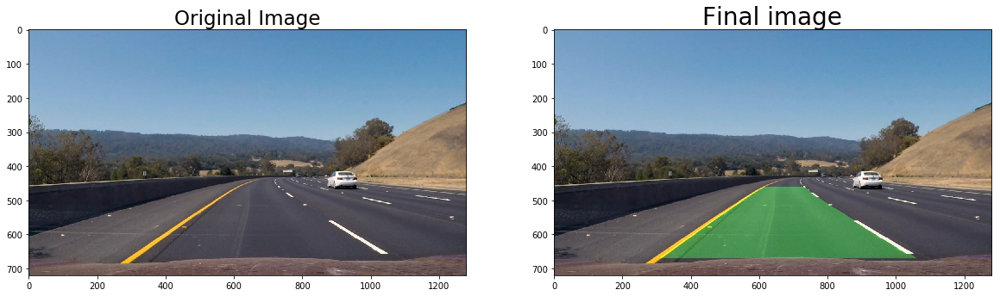

In [45]:
for eachImg in allImages:
    img = cv2.imread('./test_images/'+eachImg)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img, cmap='gray')
    
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    # recived undistored image
    plt.imshow(undist, cmap='gray')
    
        # wrap image 

    warped_image,M,Minv= warp_image(undist)
     
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=28)
    ax2.imshow(warped_image)
    ax2.set_title('Warped Image', fontsize=28)
    plt.savefig('./warped_image_output/'+eachImg)
    #cv2.imwrite('./camera_cal_output/'+img.split('/')[-1],(ax1,ax2))
    #plt.imshow(final_img)

    combined = combined_thresh(warped_image, sobel_kernel=3, abs_thresh=(20,255), _mag_thresh=(20,255), dir_thresh=(0, np.pi/2))
    
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=23)
    ax2.imshow(combined)
    ax2.set_title('Perspective transform with gradient', fontsize=28)
    plt.savefig('./perspective_transform_output/'+eachImg)
    #plt.imshow(combined, cmap='gray')
    
    
    left_fit, right_fit, left_lane_inds, right_lane_inds, out_img = sliding_window_polyfit(combined)

    visualize_polyfit(combined, out_img, left_fit, right_fit, left_lane_inds, right_lane_inds)

    out_img, left_fit2, right_fit2, left_lane_inds2, right_lane_inds2 = skip_windows_step(combined, left_fit, right_fit)

    visualize_skip_window_step(combined, out_img, left_fit2, right_fit2, left_lane_inds2, right_lane_inds2)
    
    left_curverad, right_curverad = measure_curvature(combined, left_lane_inds2, right_lane_inds2)

    # print(left_curverad, 'm', right_curverad, 'm')

    car_pos = measure_car_pos(combined, left_fit2, right_fit2)

    # print(car_pos, 'm')

    new_img = draw_lines(img, combined, left_fit, right_fit, Minv)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=23)
    ax2.imshow(new_img)
    ax2.set_title('Final image', fontsize=28)
    plt.savefig('./output_images/'+ eachImg)    

In [20]:
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False      
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = []  
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        
    def add_best_fit(self, lane_fit, lane_inds):
        if lane_fit is not None:
            if self.best_fit is not None:
                self.diffs = abs(lane_fit - self.best_fit)
            if (self.diffs[0] > 0.001 or self.diffs[1] > 1.0 or self.diffs[2] > 100.) and len(self.current_fit) > 0:
                self.detected = False
            else:
                self.detected = True
                self.px_count = np.count_nonzero(lane_inds)
                self.current_fit.append(lane_fit)
                if len(self.current_fit) > 5:
                    self.current_fit = self.current_fit[len(self.current_fit)-5:]
                self.best_fit = lane_fit
        else:
            self.detected = False
            if len(self.current_fit) > 0:
                self.current_fit = self.current_fit[:len(self.current_fit)-1]
                self.best_fit = np.average(self.current_fit, axis=0)

In [21]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [ ]:
!conda install -c conda-forge moviepy 

In [ ]:
!pip3 install imageio-ffmpeg

In [22]:
def process_img(img):  
    original_img = np.copy(img)
    
    undist = cv2.undistort(original_img, mtx, dist, None, mtx)
    
    warped_image, M, Minv = warp_image(undist)
    
    binary_img = combined_thresh(warped_image)
    
    if not left_line.detected or not right_line.detected:
        left_fit, right_fit, left_lane_inds, right_lane_inds, out_img = sliding_window_polyfit(binary_img)
    else:
        out_img, left_fit, right_fit, left_lane_inds, right_lane_inds = skip_windows_step(binary_img, left_line.best_fit, right_line.best_fit)
    
    left_line.add_best_fit(left_fit, left_lane_inds)
    right_line.add_best_fit(right_fit, right_lane_inds)
        
    if left_line.best_fit is not None and right_line.best_fit is not None:
        new_img = draw_lines(original_img, binary_img, left_line.best_fit, right_line.best_fit, Minv)
        
        left_curverad, right_curverad = measure_curvature(binary_img, left_lane_inds, right_lane_inds)
        car_pos = measure_car_pos(binary_img, left_line.best_fit, right_line.best_fit)
        
        final_img = draw_curvature_data(new_img, (left_curverad + right_curverad)/2, car_pos)
    else:
        new_img = original_img
    
    return new_img

In [48]:
left_line = Line()
right_line = Line()

video_output1 = 'harder_challenge_video_output.mp4'
video_input1 = VideoFileClip('/home/devesh/udac_nd/CarND-Advanced-Lane-Lines/harder_challenge_video.mp4')
processed_video = video_input1.fl_image(process_img)
%time processed_video.write_videofile(video_output1, audio=False)

[MoviePy] >>>> Building video harder_challenge_video_output.mp4
[MoviePy] Writing video harder_challenge_video_output.mp4



 13%|█▎        | 152/1200 [00:35<04:06,  4.24it/s]


 25%|██▌       | 303/1200 [01:15<03:57,  3.78it/s]


 38%|███▊      | 454/1200 [01:57<02:41,  4.62it/s]


 50%|█████     | 605/1200 [02:32<02:23,  4.14it/s]


 63%|██████▎   | 756/1200 [03:16<02:00,  3.68it/s]


 76%|███████▌  | 907/1200 [03:58<01:14,  3.93it/s]


 88%|████████▊ | 1057/1200 [04:35<00:32,  4.37it/s]


100%|█████████▉| 1199/1200 [05:13<00:00,  3.64it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: harder_challenge_video_output.mp4 

CPU times: user 16min 21s, sys: 20.9 s, total: 16min 42s
Wall time: 5min 15s


In [36]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_input1))